<a href="https://colab.research.google.com/github/SuryanshPrasad/Heart-Failure-Prediction-using-Databricks/blob/main/Heart_Failure_Prediction_Final_with_Models_(1).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
pip install missingno

Python interpreter will be restarted.
Python interpreter will be restarted.


In [ ]:
from pyspark.sql import SparkSession
from pyspark.sql.functions import * # first time I imported every possible function but it is not efficient
from pyspark.sql.functions import when, count, col
import missingno as msno

In [ ]:
# list of all files
dbutils.fs.ls("/FileStore/tables")

Out[2]: [FileInfo(path='dbfs:/FileStore/tables/ContainsNull.csv', name='ContainsNull.csv', size=61, modificationTime=1676496836000),
 FileInfo(path='dbfs:/FileStore/tables/SMSSpamCollection', name='SMSSpamCollection', size=477907, modificationTime=1679950636000),
 FileInfo(path='dbfs:/FileStore/tables/SMSSpamCollection-1.csv', name='SMSSpamCollection-1.csv', size=480845, modificationTime=1679948706000),
 FileInfo(path='dbfs:/FileStore/tables/SMSSpamCollection.csv', name='SMSSpamCollection.csv', size=480845, modificationTime=1679948379000),
 FileInfo(path='dbfs:/FileStore/tables/appl_stock.csv', name='appl_stock.csv', size=143130, modificationTime=1676496837000),
 FileInfo(path='dbfs:/FileStore/tables/apple_stock.csv', name='apple_stock.csv', size=72675, modificationTime=1680823456000),
 FileInfo(path='dbfs:/FileStore/tables/healthcare_dataset_stroke_data-1.csv', name='healthcare_dataset_stroke_data-1.csv', size=316971, modificationTime=1677163129000),
 FileInfo(path='dbfs:/FileStore/ta

In [ ]:
spark = SparkSession.builder.appName("PredictionProject").getOrCreate()

In [ ]:
import os
print(os.getcwd())

/databricks/driver


Kaggle Data Link - https://www.kaggle.com/datasets/fedesoriano/stroke-prediction-dataset

In [ ]:
# Might be a little slow locally
heart = spark.read.csv(('/FileStore/tables/healthcare_dataset_stroke_data-3.csv'),inferSchema=True,header=True)

In [ ]:
import pandas as pd
heart.show()

+-----+------+----+------------+-------------+------------+-------------+--------------+-----------------+----+---------------+------+
|   id|gender| age|hypertension|heart_disease|ever_married|    work_type|Residence_type|avg_glucose_level| bmi| smoking_status|stroke|
+-----+------+----+------------+-------------+------------+-------------+--------------+-----------------+----+---------------+------+
| 9046|  Male|67.0|           0|            1|         Yes|      Private|         Urban|           228.69|36.6|formerly smoked|     1|
|51676|Female|61.0|           0|            0|         Yes|Self-employed|         Rural|           202.21| N/A|   never smoked|     1|
|31112|  Male|80.0|           0|            1|         Yes|      Private|         Rural|           105.92|32.5|   never smoked|     1|
|60182|Female|49.0|           0|            0|         Yes|      Private|         Urban|           171.23|34.4|         smokes|     1|
| 1665|Female|79.0|           1|            0|         

In [ ]:
heart.printSchema()

root
 |-- id: integer (nullable = true)
 |-- gender: string (nullable = true)
 |-- age: double (nullable = true)
 |-- hypertension: integer (nullable = true)
 |-- heart_disease: integer (nullable = true)
 |-- ever_married: string (nullable = true)
 |-- work_type: string (nullable = true)
 |-- Residence_type: string (nullable = true)
 |-- avg_glucose_level: double (nullable = true)
 |-- bmi: string (nullable = true)
 |-- smoking_status: string (nullable = true)
 |-- stroke: integer (nullable = true)



## Changing Variable type of some variables

In [ ]:
#from pyspark.sql.types import StructField,StringType,IntegerType,DoubleType,StructType

#heart_schema = StructType([
 #   StructField('id', IntegerType(), True),
 #   StructField('gender', StringType(), True),
 #   StructField('age', DoubleType(), True),
 #   StructField('hypertension', IntegerType(), True),
 #   StructField('heart_disease', IntegerType(), True),
 #   StructField('ever_married', StringType(), True),
 #   StructField('work_type', StringType(), True),
 #   StructField('Residence_type', StringType(), True),
 #   StructField('avg_glucose_level', IntegerType(), True),
 #   StructField('bmi', IntegerType(), True),
 #   StructField('smoking_status', StringType(), True),
 #   StructField('stroke', IntegerType(), True)
  #  ])
#heart = spark.createDataFrame(heart.collect(),schema = heart_schema)
#heart.printSchema()

# We tried using the StrucType to change the data types but some of the values are in double for some variables due to which we preferred using cast function to switch those variables.


In [ ]:
# changing datatypes for some variables
heart = heart.withColumn("age", heart["age"].cast("integer"))
heart = heart.withColumn("bmi", heart["bmi"].cast("integer"))
heart = heart.withColumn("avg_glucose_level", heart["avg_glucose_level"].cast("integer"))




In [ ]:
# dimensions of the dataframe
print("Number of Rows: ",heart.count() ,"   Number of Columns: ", len(heart.columns))

Number of Rows:  5110    Number of Columns:  12


##DATA DICTIONARY

- id: unique identifier for patient
- gender: "Male" or "Female" in the dataset
- age: age of the patient
- hypertension: 1 if the patient has hypertension, 0 otherwise.
- heart_disease: 1 if the patient has heart disease, 0 otherwise.
- ever_married: "Yes" or "No" if the patient was married or not
- work_type: type of occupation patient is in
- Residence_type: type of residence the patient resides in
- avg_glucose_level: average glucose level in blood of the patient.
- bmi: body mass index of the patient
- smoking_status: smoking status of the patient
- stroke: 1 if the patient had a stroke, 0 otherwise (target variable)




## Exploratary Data Analysis

In [ ]:
heart.describe().show()

+-------+-----------------+------+------------------+------------------+-------------------+------------+---------+--------------+------------------+------------------+--------------+-------------------+
|summary|               id|gender|               age|      hypertension|      heart_disease|ever_married|work_type|Residence_type| avg_glucose_level|               bmi|smoking_status|             stroke|
+-------+-----------------+------+------------------+------------------+-------------------+------------+---------+--------------+------------------+------------------+--------------+-------------------+
|  count|             5110|  5110|              5110|              5110|               5110|        5110|     5110|          5110|              5110|              4909|          5110|               5110|
|   mean|36517.82935420744|  null| 43.21526418786693|0.0974559686888454|0.05401174168297456|        null|     null|          null|105.65831702544031|28.448563862293746|          null| 

In [ ]:
# The descriptive Statistics of the numerical coolumns
heart.select('age','hypertension','heart_disease','bmi').describe().show()


+-------+------------------+------------------+-------------------+------------------+
|summary|               age|      hypertension|      heart_disease|               bmi|
+-------+------------------+------------------+-------------------+------------------+
|  count|              5110|              5110|               5110|              4909|
|   mean| 43.21526418786693|0.0974559686888454|0.05401174168297456|28.448563862293746|
| stddev|22.633865752854746| 0.296606674233791|0.22606298750336554| 7.843833618220339|
|    min|                 0|                 0|                  0|                10|
|    max|                82|                 1|                  1|                97|
+-------+------------------+------------------+-------------------+------------------+



In [ ]:
heart.groupBy("stroke").count().show()

+------+-----+
|stroke|count|
+------+-----+
|     1|  249|
|     0| 4861|
+------+-----+



In [ ]:
# we should handle the missing values by imputation unless too many of them are emtpy
# na.drop() method is not recommended for avoiding biased
heart.select([count(when(isnull(a), a)).alias(a) for a in heart.columns]).show()


+---+------+---+------------+-------------+------------+---------+--------------+-----------------+---+--------------+------+
| id|gender|age|hypertension|heart_disease|ever_married|work_type|Residence_type|avg_glucose_level|bmi|smoking_status|stroke|
+---+------+---+------------+-------------+------------+---------+--------------+-----------------+---+--------------+------+
|  0|     0|  0|           0|            0|           0|        0|             0|                0|201|             0|     0|
+---+------+---+------------+-------------+------------+---------+--------------+-----------------+---+--------------+------+



Out[15]: <AxesSubplot:>

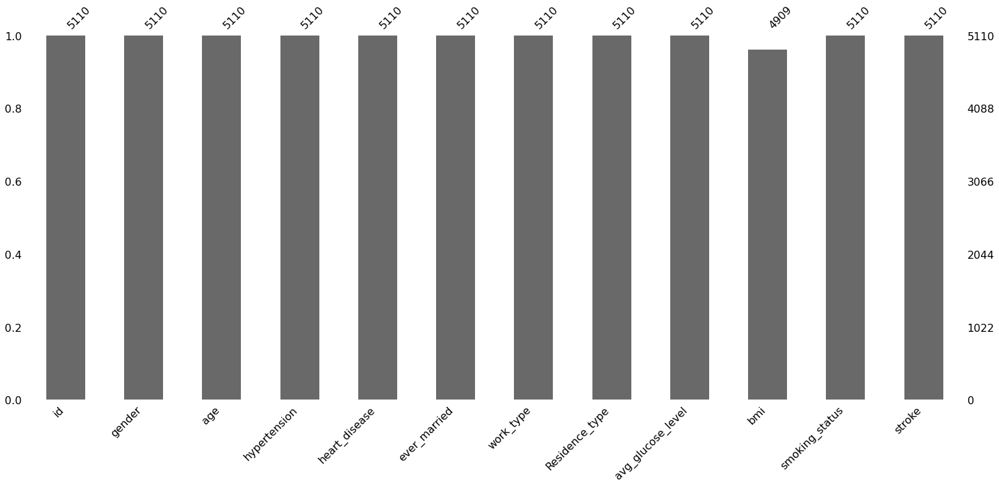

In [ ]:
msno.bar(heart.toPandas())

Out[16]: <AxesSubplot:>

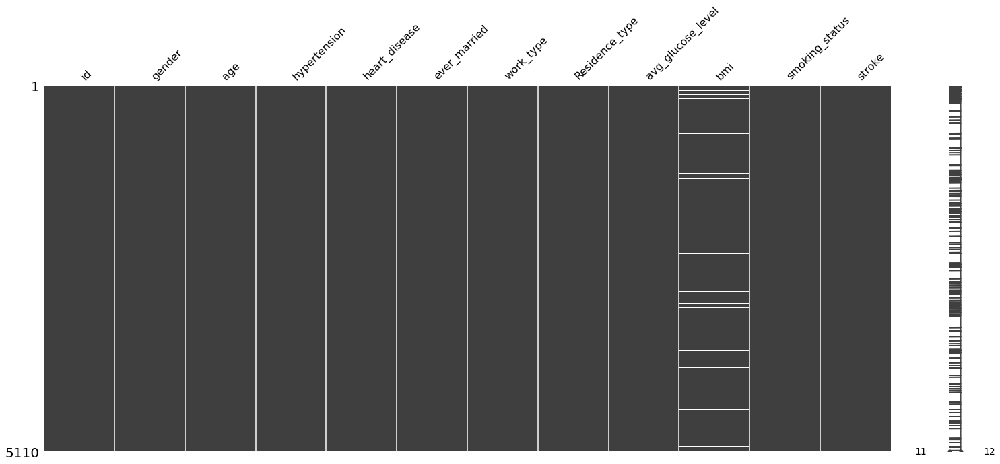

In [ ]:
msno.matrix(heart.toPandas())

Out[17]: <AxesSubplot:>

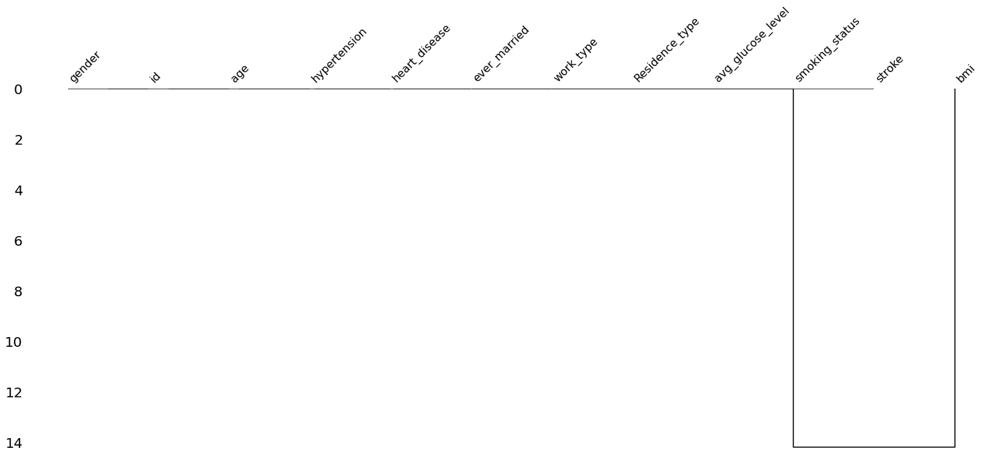

In [ ]:
msno.dendrogram(heart.toPandas())

In [ ]:
# as the amoking_status & bmi are related in the dendrogram
# Fill missing values in smoking_status with 'No info'
heart = heart.withColumn('smoking_status', when(heart.smoking_status.isNull(), 'No info').otherwise(heart.smoking_status))

# Fill missing values in bmi with 0
heart = heart.withColumn('bmi', when(heart.bmi.isNull(), '0').otherwise(heart.bmi))



In [ ]:
null_report = heart.select([count(when(isnull(a), a)).alias(a) for a in heart.columns])
null_report.show()

+---+------+---+------------+-------------+------------+---------+--------------+-----------------+---+--------------+------+
| id|gender|age|hypertension|heart_disease|ever_married|work_type|Residence_type|avg_glucose_level|bmi|smoking_status|stroke|
+---+------+---+------------+-------------+------------+---------+--------------+-----------------+---+--------------+------+
|  0|     0|  0|           0|            0|           0|        0|             0|                0|  0|             0|     0|
+---+------+---+------------+-------------+------------+---------+--------------+-----------------+---+--------------+------+



In [ ]:
# Checking emptiness proportion in each column
for field in null_report.schema.fields:
        name = str(field.name)
        null_report = null_report.withColumn(name, round(col(name)/heart.count(),4))
null_report.show()

+---+------+---+------------+-------------+------------+---------+--------------+-----------------+---+--------------+------+
| id|gender|age|hypertension|heart_disease|ever_married|work_type|Residence_type|avg_glucose_level|bmi|smoking_status|stroke|
+---+------+---+------------+-------------+------------+---------+--------------+-----------------+---+--------------+------+
|0.0|   0.0|0.0|         0.0|          0.0|         0.0|      0.0|           0.0|              0.0|0.0|           0.0|   0.0|
+---+------+---+------------+-------------+------------+---------+--------------+-----------------+---+--------------+------+



In [ ]:
#changing datatype back to integer
heart = heart.withColumn("bmi", heart["bmi"].cast("integer"))

In [ ]:
heart.registerTempTable("dataclean")
display(sqlContext.sql("select * from dataclean"))

/databricks/spark/python/pyspark/sql/dataframe.py:331: FutureWarning: Deprecated in 2.0, use createOrReplaceTempView instead.
  warnings.warn("Deprecated in 2.0, use createOrReplaceTempView instead.", FutureWarning)


id,gender,age,hypertension,heart_disease,ever_married,work_type,Residence_type,avg_glucose_level,bmi,smoking_status,stroke
9046,Male,67,0,1,Yes,Private,Urban,228,36,formerly smoked,1
51676,Female,61,0,0,Yes,Self-employed,Rural,202,0,never smoked,1
31112,Male,80,0,1,Yes,Private,Rural,105,32,never smoked,1
60182,Female,49,0,0,Yes,Private,Urban,171,34,smokes,1
1665,Female,79,1,0,Yes,Self-employed,Rural,174,24,never smoked,1
56669,Male,81,0,0,Yes,Private,Urban,186,29,formerly smoked,1
53882,Male,74,1,1,Yes,Private,Rural,70,27,never smoked,1
10434,Female,69,0,0,No,Private,Urban,94,22,never smoked,1
27419,Female,59,0,0,Yes,Private,Rural,76,0,Unknown,1
60491,Female,78,0,0,Yes,Private,Urban,58,24,Unknown,1


Databricks data profile. Run in Databricks to view.

In [ ]:
# The descriptive Statistics of the numerical coolumns
heart.select('age','hypertension','heart_disease','bmi').describe().show()

+-------+------------------+------------------+-------------------+------------------+
|summary|               age|      hypertension|      heart_disease|               bmi|
+-------+------------------+------------------+-------------------+------------------+
|  count|              5110|              5110|               5110|              5110|
|   mean| 43.21526418786693|0.0974559686888454|0.05401174168297456|27.329549902152642|
| stddev|22.633865752854746| 0.296606674233791|0.22606298750336554| 9.470654348479238|
|    min|                 0|                 0|                  0|                 0|
|    max|                82|                 1|                  1|                97|
+-------+------------------+------------------+-------------------+------------------+



## Distribution of the data after cleaning the dataset

In [ ]:
# distribution of cities in database for each category of survival
display(sqlContext.sql("select * from dataclean"))

id,gender,age,hypertension,heart_disease,ever_married,work_type,Residence_type,avg_glucose_level,bmi,smoking_status,stroke
9046,Male,67,0,1,Yes,Private,Urban,228,36,formerly smoked,1
51676,Female,61,0,0,Yes,Self-employed,Rural,202,0,never smoked,1
31112,Male,80,0,1,Yes,Private,Rural,105,32,never smoked,1
60182,Female,49,0,0,Yes,Private,Urban,171,34,smokes,1
1665,Female,79,1,0,Yes,Self-employed,Rural,174,24,never smoked,1
56669,Male,81,0,0,Yes,Private,Urban,186,29,formerly smoked,1
53882,Male,74,1,1,Yes,Private,Rural,70,27,never smoked,1
10434,Female,69,0,0,No,Private,Urban,94,22,never smoked,1
27419,Female,59,0,0,Yes,Private,Rural,76,0,Unknown,1
60491,Female,78,0,0,Yes,Private,Urban,58,24,Unknown,1


Databricks visualization. Run in Databricks to view.

## We can definitely say Married people on an average smoked occasionally or regularly.

In [ ]:
#through this code we see the amount of patients in each working categories
heart.where(heart.stroke == 1)\
  .groupBy('work_type')\
  .agg(count('work_type').alias('work_type_count'))\
  .orderBy('work_type_count', ascending=False)\
  .show()


+-------------+---------------+
|    work_type|work_type_count|
+-------------+---------------+
|      Private|            149|
|Self-employed|             65|
|     Govt_job|             33|
|     children|              2|
+-------------+---------------+



In [ ]:
# distribution of cities in database for each category of survival
display(sqlContext.sql("select * from dataclean"))

id,gender,age,hypertension,heart_disease,ever_married,work_type,Residence_type,avg_glucose_level,bmi,smoking_status,stroke
9046,Male,67,0,1,Yes,Private,Urban,228,36,formerly smoked,1
51676,Female,61,0,0,Yes,Self-employed,Rural,202,0,never smoked,1
31112,Male,80,0,1,Yes,Private,Rural,105,32,never smoked,1
60182,Female,49,0,0,Yes,Private,Urban,171,34,smokes,1
1665,Female,79,1,0,Yes,Self-employed,Rural,174,24,never smoked,1
56669,Male,81,0,0,Yes,Private,Urban,186,29,formerly smoked,1
53882,Male,74,1,1,Yes,Private,Rural,70,27,never smoked,1
10434,Female,69,0,0,No,Private,Urban,94,22,never smoked,1
27419,Female,59,0,0,Yes,Private,Rural,76,0,Unknown,1
60491,Female,78,0,0,Yes,Private,Urban,58,24,Unknown,1


Databricks visualization. Run in Databricks to view.

## From above results, it looks like private ocupation is the most dangerous

In [ ]:
from pyspark.sql.functions import count, round

# Group the data by gender and count the number of records for each gender
gender_counts = heart.groupBy("gender").agg(count("*").alias("count_gender"))

# Calculate the percentage of each gender in the dataset
total_count = heart.count()
gender_percentages = gender_counts.withColumn("percent", round((gender_counts["count_gender"] * 100 / total_count), 2))

# Show the results
gender_percentages.show()


+------+------------+-------+
|gender|count_gender|percent|
+------+------------+-------+
|Female|        2994|  58.59|
| Other|           1|   0.02|
|  Male|        2115|  41.39|
+------+------------+-------+



In [ ]:
# distribution of cities in database for each category of survival
display(sqlContext.sql("select * from dataclean"))

id,gender,age,hypertension,heart_disease,ever_married,work_type,Residence_type,avg_glucose_level,bmi,smoking_status,stroke
9046,Male,67,0,1,Yes,Private,Urban,228,36,formerly smoked,1
51676,Female,61,0,0,Yes,Self-employed,Rural,202,0,never smoked,1
31112,Male,80,0,1,Yes,Private,Rural,105,32,never smoked,1
60182,Female,49,0,0,Yes,Private,Urban,171,34,smokes,1
1665,Female,79,1,0,Yes,Self-employed,Rural,174,24,never smoked,1
56669,Male,81,0,0,Yes,Private,Urban,186,29,formerly smoked,1
53882,Male,74,1,1,Yes,Private,Rural,70,27,never smoked,1
10434,Female,69,0,0,No,Private,Urban,94,22,never smoked,1
27419,Female,59,0,0,Yes,Private,Rural,76,0,Unknown,1
60491,Female,78,0,0,Yes,Private,Urban,58,24,Unknown,1


Databricks visualization. Run in Databricks to view.

## this is the count & percentage of males and females in the dataset, we can definitely say there are more womens in the dataset and also more number of mens are having heart disease when compared to women.

In [ ]:
# Group by gender and count the number of strokes for each group
gender_stroke_counts = heart.groupBy("gender").agg(count(when(heart.stroke == 1, True)).alias("stroke_count"))

# Calculate percentage using window function
total_strokes = heart.agg(sum(when(heart.stroke == 1, 1)).alias("total_strokes")).collect()[0]["total_strokes"]
gender_stroke_counts = gender_stroke_counts.withColumn("stroke_percent", round(gender_stroke_counts["stroke_count"] / total_strokes * 100, 2))

# Show the result
gender_stroke_counts.show()

+------+------------+--------------+
|gender|stroke_count|stroke_percent|
+------+------------+--------------+
|Female|         141|         56.63|
| Other|           0|           0.0|
|  Male|         108|         43.37|
+------+------------+--------------+



In [ ]:
# distribution of cities in database for each category of survival
display(sqlContext.sql("select * from dataclean"))

id,gender,age,hypertension,heart_disease,ever_married,work_type,Residence_type,avg_glucose_level,bmi,smoking_status,stroke
9046,Male,67,0,1,Yes,Private,Urban,228,36,formerly smoked,1
51676,Female,61,0,0,Yes,Self-employed,Rural,202,0,never smoked,1
31112,Male,80,0,1,Yes,Private,Rural,105,32,never smoked,1
60182,Female,49,0,0,Yes,Private,Urban,171,34,smokes,1
1665,Female,79,1,0,Yes,Self-employed,Rural,174,24,never smoked,1
56669,Male,81,0,0,Yes,Private,Urban,186,29,formerly smoked,1
53882,Male,74,1,1,Yes,Private,Rural,70,27,never smoked,1
10434,Female,69,0,0,No,Private,Urban,94,22,never smoked,1
27419,Female,59,0,0,Yes,Private,Rural,76,0,Unknown,1
60491,Female,78,0,0,Yes,Private,Urban,58,24,Unknown,1


Databricks visualization. Run in Databricks to view.

## Amount of males & females who got a Stroke in the dataset, from this visualization we can definitely say men and women who weren't married and were young didnt get any stroke and had any heart disease even if they were smoking but after when they got married they were more prone to having a heart disease and getting a stroke later down the road.



In [ ]:
heart.filter(heart.stroke == 1).groupBy('age').agg(count('age').alias('age_count')).orderBy('age_count', ascending=False).show()


+---+---------+
|age|age_count|
+---+---------+
| 78|       21|
| 80|       17|
| 79|       17|
| 81|       14|
| 57|       11|
| 76|       10|
| 63|        9|
| 82|        9|
| 68|        9|
| 74|        9|
| 59|        8|
| 77|        8|
| 58|        7|
| 71|        7|
| 54|        6|
| 61|        6|
| 72|        6|
| 69|        6|
| 70|        6|
| 75|        6|
+---+---------+
only showing top 20 rows



In [ ]:
# distribution of cities in database for each category of survival
display(sqlContext.sql("select * from dataclean"))

id,gender,age,hypertension,heart_disease,ever_married,work_type,Residence_type,avg_glucose_level,bmi,smoking_status,stroke
9046,Male,67,0,1,Yes,Private,Urban,228,36,formerly smoked,1
51676,Female,61,0,0,Yes,Self-employed,Rural,202,0,never smoked,1
31112,Male,80,0,1,Yes,Private,Rural,105,32,never smoked,1
60182,Female,49,0,0,Yes,Private,Urban,171,34,smokes,1
1665,Female,79,1,0,Yes,Self-employed,Rural,174,24,never smoked,1
56669,Male,81,0,0,Yes,Private,Urban,186,29,formerly smoked,1
53882,Male,74,1,1,Yes,Private,Rural,70,27,never smoked,1
10434,Female,69,0,0,No,Private,Urban,94,22,never smoked,1
27419,Female,59,0,0,Yes,Private,Rural,76,0,Unknown,1
60491,Female,78,0,0,Yes,Private,Urban,58,24,Unknown,1


Databricks visualization. Run in Databricks to view.

## We can definitely say people who had age more than 45 and above were more prone towards getting a stroke.

In [ ]:
# distribution of cities in database for each category of survival
display(sqlContext.sql("select * from dataclean"))

id,gender,age,hypertension,heart_disease,ever_married,work_type,Residence_type,avg_glucose_level,bmi,smoking_status,stroke
9046,Male,67,0,1,Yes,Private,Urban,228,36,formerly smoked,1
51676,Female,61,0,0,Yes,Self-employed,Rural,202,0,never smoked,1
31112,Male,80,0,1,Yes,Private,Rural,105,32,never smoked,1
60182,Female,49,0,0,Yes,Private,Urban,171,34,smokes,1
1665,Female,79,1,0,Yes,Self-employed,Rural,174,24,never smoked,1
56669,Male,81,0,0,Yes,Private,Urban,186,29,formerly smoked,1
53882,Male,74,1,1,Yes,Private,Rural,70,27,never smoked,1
10434,Female,69,0,0,No,Private,Urban,94,22,never smoked,1
27419,Female,59,0,0,Yes,Private,Rural,76,0,Unknown,1
60491,Female,78,0,0,Yes,Private,Urban,58,24,Unknown,1


Databricks visualization. Run in Databricks to view.

## We can definitely say more females suffered from a stroke when comapred to men.

In [ ]:
# distribution of cities in database for each category of survival
display(sqlContext.sql("select * from dataclean"))

id,gender,age,hypertension,heart_disease,ever_married,work_type,Residence_type,avg_glucose_level,bmi,smoking_status,stroke
9046,Male,67,0,1,Yes,Private,Urban,228,36,formerly smoked,1
51676,Female,61,0,0,Yes,Self-employed,Rural,202,0,never smoked,1
31112,Male,80,0,1,Yes,Private,Rural,105,32,never smoked,1
60182,Female,49,0,0,Yes,Private,Urban,171,34,smokes,1
1665,Female,79,1,0,Yes,Self-employed,Rural,174,24,never smoked,1
56669,Male,81,0,0,Yes,Private,Urban,186,29,formerly smoked,1
53882,Male,74,1,1,Yes,Private,Rural,70,27,never smoked,1
10434,Female,69,0,0,No,Private,Urban,94,22,never smoked,1
27419,Female,59,0,0,Yes,Private,Rural,76,0,Unknown,1
60491,Female,78,0,0,Yes,Private,Urban,58,24,Unknown,1


Databricks visualization. Run in Databricks to view.

## From the above pie-chart it can be said that almost 50% of the people in the dataset smoked ocasionally or regularly and they were also having a underlying heart disease at the same time, and all of this resulted towards having a stroke.


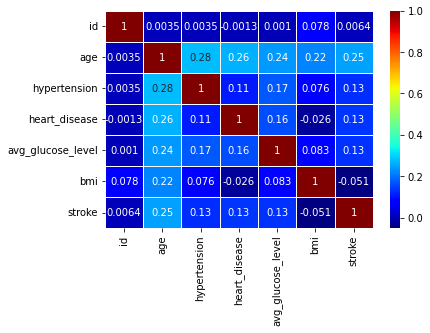

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
# Generating Heatmap
# generate correlation matrix
corr_matrix = heart.toPandas().corr()

# create heatmap using seaborn library
sns.heatmap(corr_matrix, annot=True, cmap='jet', linewidths=0.5)

# display heatmap
plt.show()

## Heat-map of the dataset, there's certainly some relationship between stroke & age and also very slight with Hypertension, heart_disease and Blood Glucose Level.

In [ ]:
heart.registerTempTable("dataclean")
display(sqlContext.sql("select * from dataclean"))

/databricks/spark/python/pyspark/sql/dataframe.py:331: FutureWarning: Deprecated in 2.0, use createOrReplaceTempView instead.
  warnings.warn("Deprecated in 2.0, use createOrReplaceTempView instead.", FutureWarning)


id,gender,age,hypertension,heart_disease,ever_married,work_type,Residence_type,avg_glucose_level,bmi,smoking_status,stroke
9046,Male,67,0,1,Yes,Private,Urban,228,36,formerly smoked,1
51676,Female,61,0,0,Yes,Self-employed,Rural,202,0,never smoked,1
31112,Male,80,0,1,Yes,Private,Rural,105,32,never smoked,1
60182,Female,49,0,0,Yes,Private,Urban,171,34,smokes,1
1665,Female,79,1,0,Yes,Self-employed,Rural,174,24,never smoked,1
56669,Male,81,0,0,Yes,Private,Urban,186,29,formerly smoked,1
53882,Male,74,1,1,Yes,Private,Rural,70,27,never smoked,1
10434,Female,69,0,0,No,Private,Urban,94,22,never smoked,1
27419,Female,59,0,0,Yes,Private,Rural,76,0,Unknown,1
60491,Female,78,0,0,Yes,Private,Urban,58,24,Unknown,1


Databricks visualization. Run in Databricks to view.

## Males tend to have Higher Blood Glucose Level when to comapred to females.

In [ ]:
heart.registerTempTable("dataclean")
display(sqlContext.sql("select * from dataclean"))

id,gender,age,hypertension,heart_disease,ever_married,work_type,Residence_type,avg_glucose_level,bmi,smoking_status,stroke
9046,Male,67,0,1,Yes,Private,Urban,228,36,formerly smoked,1
51676,Female,61,0,0,Yes,Self-employed,Rural,202,0,never smoked,1
31112,Male,80,0,1,Yes,Private,Rural,105,32,never smoked,1
60182,Female,49,0,0,Yes,Private,Urban,171,34,smokes,1
1665,Female,79,1,0,Yes,Self-employed,Rural,174,24,never smoked,1
56669,Male,81,0,0,Yes,Private,Urban,186,29,formerly smoked,1
53882,Male,74,1,1,Yes,Private,Rural,70,27,never smoked,1
10434,Female,69,0,0,No,Private,Urban,94,22,never smoked,1
27419,Female,59,0,0,Yes,Private,Rural,76,0,Unknown,1
60491,Female,78,0,0,Yes,Private,Urban,58,24,Unknown,1


Databricks visualization. Run in Databricks to view.

## Definitely Married people on an average had Blood Glucose Level more than the normal range which resulted in getting a stroke.

### Working with Categorical Columns



In [ ]:
# we exclude unrelevant columns of Work_type and id maybe reseidence if no sense
my_data = heart.select(['hypertension', 'age', 'heart_disease', 'avg_glucose_level', 'stroke', 'gender', 'bmi', 'smoking_status', 'work_type', 'Residence_type', 'ever_married'])

###Encoding Variables for Feature Selection

In [ ]:
from pyspark.ml.feature import (VectorAssembler,VectorIndexer,
                                OneHotEncoder,StringIndexer)
from pyspark.ml.evaluation import BinaryClassificationEvaluator
from pyspark.ml.feature import ChiSqSelector
from pyspark.ml.classification import LogisticRegression, RandomForestClassifier, DecisionTreeClassifier, GBTClassifier
from pyspark.ml import Pipeline
from pyspark.ml.tuning import ParamGridBuilder, CrossValidator
from pyspark.ml.feature import ChiSqSelector


# Converting categorical variables to numerical using One-Hot Encoding
heart_encoded = heart.select('gender', 'age', 'hypertension', 'heart_disease', 'ever_married',
                             'work_type', 'Residence_type', 'avg_glucose_level', 'bmi', 'smoking_status',
                             col('stroke').cast('int').alias('label'))

heart_encoded = spark.createDataFrame(
    heart_encoded.rdd.map(lambda row: tuple(row) + tuple([row.gender == 'Male', row.smoking_status == 'smokes'])),
    heart_encoded.schema.add('is_male', 'boolean').add('smokes', 'boolean')
)

### Testing & Training Data

In [ ]:
train_data, test_data = heart_encoded.randomSplit([0.7,0.3],seed=123)

In [ ]:
# Create vector assembler to combine features
vector_assembler = VectorAssembler(inputCols=['age', 'hypertension', 'heart_disease', 'avg_glucose_level',
                                              'bmi', 'is_male', 'smokes'], outputCol='my_features')

## Defining Pipeline

Feature Selection using Chi-Squares Test

In [ ]:
# Feature selection using Chi-Square test
feature_selector = ChiSqSelector(numTopFeatures=3, featuresCol="my_features", outputCol="selectedFeatures", labelCol="label")

### Applying Machine Learning Models

In [ ]:
# Define machine learning models
lr = LogisticRegression(featuresCol='selectedFeatures', labelCol='label', maxIter=10)
rf = RandomForestClassifier(featuresCol='selectedFeatures', labelCol='label', numTrees=100)
dt = DecisionTreeClassifier(featuresCol='selectedFeatures', labelCol='label', maxDepth=5)
gbt = GBTClassifier(featuresCol='selectedFeatures', labelCol='label', maxIter=10)


In [ ]:
# Create pipelines for each model
lr_pipeline = Pipeline(stages=[vector_assembler, feature_selector, lr])
rf_pipeline = Pipeline(stages=[vector_assembler, feature_selector, rf])
dt_pipeline = Pipeline(stages=[vector_assembler, feature_selector, dt])
gbt_pipeline = Pipeline(stages=[vector_assembler, feature_selector, gbt])

In [ ]:
# Train the models using cross validation
paramGrid = ParamGridBuilder().build()

lr_crossval = CrossValidator(estimator=lr_pipeline, estimatorParamMaps=paramGrid, evaluator=BinaryClassificationEvaluator(), numFolds=5)
rf_crossval = CrossValidator(estimator=rf_pipeline, estimatorParamMaps=paramGrid, evaluator=BinaryClassificationEvaluator(), numFolds=5)
dt_crossval = CrossValidator(estimator=dt_pipeline, estimatorParamMaps=paramGrid, evaluator=BinaryClassificationEvaluator(), numFolds=5)
gbt_crossval = CrossValidator(estimator=gbt_pipeline, estimatorParamMaps=paramGrid, evaluator=BinaryClassificationEvaluator(), numFolds=5)

In [ ]:
lr_model = lr_crossval.fit(train_data)
rf_model = rf_crossval.fit(train_data)
dt_model = dt_crossval.fit(train_data)
gbt_model = gbt_crossval.fit(train_data)

In [ ]:
# Make predictions on the test data
lr_predictions = lr_model.transform(test_data)
rf_predictions = rf_model.transform(test_data)
dt_predictions = dt_model.transform(test_data)
gbt_predictions = gbt_model.transform(test_data)


In [ ]:
# Evaluate the performance of each model using the BinaryClassificationEvaluator
evaluator = BinaryClassificationEvaluator(labelCol='label', rawPredictionCol='rawPrediction')


In [ ]:
# Evaluate Logistic Regression Model
lr_auc = evaluator.evaluate(lr_predictions, {evaluator.metricName: "areaUnderROC"})
lr_accuracy = lr_predictions.filter(lr_predictions.label == lr_predictions.prediction).count() / float(test_data.count())
print("Logistic Regression AUC: {:.4f}".format(lr_auc))
print("Logistic Regression Accuracy: {:.4f}".format(lr_accuracy))

Logistic Regression AUC: 0.8120
Logistic Regression Accuracy: 0.9456


In [ ]:
# Evaluate Random Forest Model
rf_auc = evaluator.evaluate(rf_predictions, {evaluator.metricName: "areaUnderROC"})
rf_accuracy = rf_predictions.filter(rf_predictions.label == rf_predictions.prediction).count() / float(test_data.count())
print("Random Forest AUC: {:.4f}".format(rf_auc))
print("Random Forest Accuracy: {:.4f}".format(rf_accuracy))

Random Forest AUC: 0.8033
Random Forest Accuracy: 0.9456


In [ ]:
# Evaluate Decision Tree Model
dt_auc = evaluator.evaluate(dt_predictions, {evaluator.metricName: "areaUnderROC"})
dt_accuracy = dt_predictions.filter(dt_predictions.label == dt_predictions.prediction).count() / float(test_data.count())
print("Decision Tree AUC: {:.4f}".format(dt_auc))
print("Decision Tree Accuracy: {:.4f}".format(dt_accuracy))
dt_predictions.select('label', 'prediction', 'probability').show(10)

Decision Tree AUC: 0.3016
Decision Tree Accuracy: 0.9443
+-----+----------+--------------------+
|label|prediction|         probability|
+-----+----------+--------------------+
|    0|       0.0|[0.98058252427184...|
|    0|       0.0|[0.98058252427184...|
|    0|       0.0|[0.98058252427184...|
|    0|       0.0|[0.98058252427184...|
|    0|       0.0|[0.98058252427184...|
|    0|       0.0|[0.98058252427184...|
|    0|       0.0|[0.98058252427184...|
|    0|       0.0|[0.98058252427184...|
|    0|       0.0|[0.98058252427184...|
|    0|       0.0|[0.98058252427184...|
+-----+----------+--------------------+
only showing top 10 rows



In [ ]:
gbt_auc = evaluator.evaluate(gbt_predictions, {evaluator.metricName: "areaUnderROC"})
gbt_accuracy = gbt_predictions.filter(gbt_predictions.label == gbt_predictions.prediction).count() / float(test_data.count())
print("Gradient-Boosted Trees AUC: {:.4f}".format(gbt_auc))
print("Gradient-Boosted Trees Accuracy: {:.4f}".format(gbt_accuracy))
gbt_predictions.select('label', 'prediction', 'probability').show(10)

Gradient-Boosted Trees AUC: 0.8042
Gradient-Boosted Trees Accuracy: 0.9443
+-----+----------+--------------------+
|label|prediction|         probability|
+-----+----------+--------------------+
|    0|       0.0|[0.93346267513555...|
|    0|       0.0|[0.93390575037572...|
|    0|       0.0|[0.92478315911344...|
|    0|       0.0|[0.93390575037572...|
|    0|       0.0|[0.93390575037572...|
|    0|       0.0|[0.92478315911344...|
|    0|       0.0|[0.93346267513555...|
|    0|       0.0|[0.93390575037572...|
|    0|       0.0|[0.93390575037572...|
|    0|       0.0|[0.93390575037572...|
+-----+----------+--------------------+
only showing top 10 rows

